In [448]:
!pip install opencv-python
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

# **IMPORT IMAGE**

In [449]:
path= "1.jpg"
widthImg = 700
heightImg = 700
questionrow=5
choices=5
ans=[1,2,0,1,4]
#webcamFeed=True
#cameranumber=1

In [450]:
# for web cam
#cap= cv2.VideoCapture(0)

#cap.set(10,150)# set brigthness
#while True:
 # if webcamFeed: success,img = cap.read()
 # else: img=cv2.imread('1.jpg')

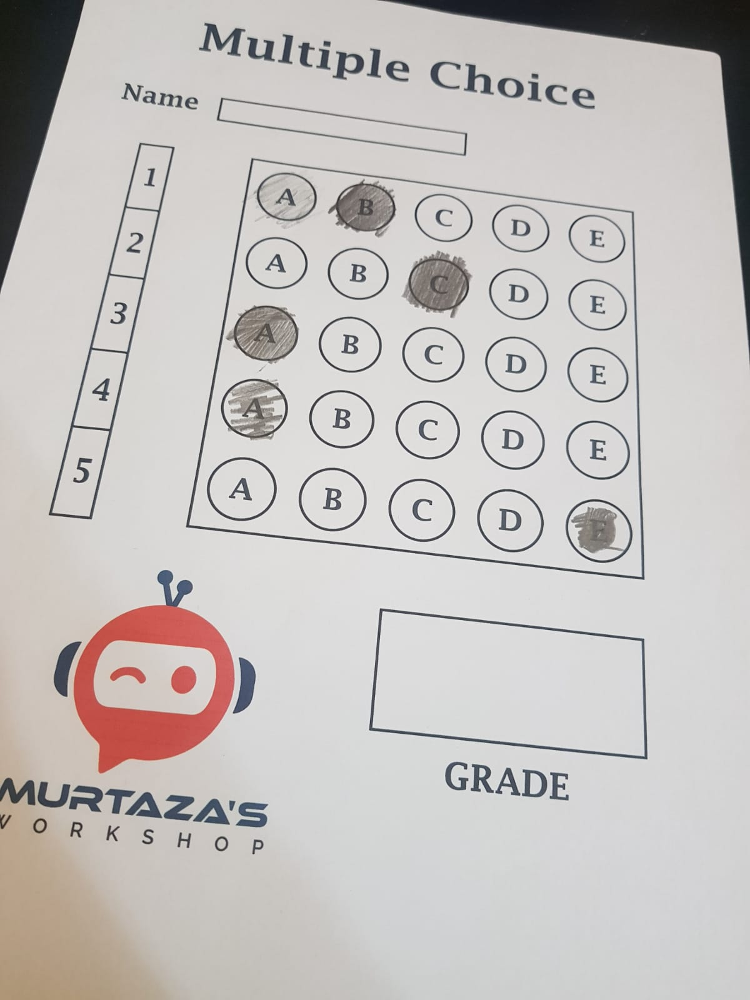

-1

In [451]:
from re import I
img = cv2.imread('1.jpg')
imgfinal=img.copy()
heightImg,widthImg,channel = img.shape
cv2_imshow(img)
cv2.waitKey(0)

# **Preprocessing**

In [452]:
img =  cv2.resize(img,(widthImg,heightImg))
imgcontours=img.copy()
imgbiggestcontours=img.copy()

In [453]:
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

In [454]:
imgBlur=cv2.GaussianBlur(img_gray,(5,5),1) # size of the kernel (5,5)
# SigmaX =1

In [455]:
imgCanny = cv2.Canny(imgBlur,10,50)# threshold values =10,50

In [456]:
# see how the images are changing
def stackImages (imgArray,scale,lables=[]):
  rows = len(imgArray)
  cols = len(imgArray[0])
  rowsAvailable = isinstance(imgArray[0], list)
  width = imgArray[0][0].shape[1]
  height = imgArray[0][0].shape[0]
  if rowsAvailable:
    for x in range (0,rows):
      for y in range(0,cols):
        imgArray[x][y] = cv2.resize(imgArray[x][y],(0,0),None,scale,scale)
        if len(imgArray[x][y].shape)==2:
          imgArray[x][y]=cv2.cvtColor(imgArray[x][y],cv2.COLOR_GRAY2BGR)
    imageBlank = np.zeros((height,width,3),np.uint8)
    hor = [imageBlank]*rows
    hor_con = [imageBlank]*rows
    for x in range(0,rows):
      hor[x] = np.hstack(imgArray[x])
      hor_con[x] = np.concatenate(imgArray[x])
    ver = np.vstack(hor)
    ver_con = np.concatenate(hor)
  else:
    for x in range(0,rows):
      imgArray[x] = cv2.resize(imgArray[x],(0,0),None, scale, scale )
      if len(imgArray[x].shape)==2:
        imgArray[x]=cv2.cvtColor(imgArray[x],cv2.COLOR_GRAY2BGR)
    hor = np.hstack(imgArray)
    hor_con = np.concatenate(imgArray)
    ver = hor
    if len(lables)!=0:
      eachImgWidth = int(ver.shape[1]/cols)
      eachImgHeight = int(ver.shape[0]/rows)
      for d in range(0,rows):
        for c in range(0,cols):
          cv2.rectangle(ver,(c*eachImgWidth,d*eachImgHeight),(c*eachImgWidth+len(lables[d][c])*13+27,30+eachImgHeight*d),(255,255,255),cv2.FILLED)
          cv2.putText(ver,lables[d][c],(eachImgWidth*c+10,eachImgHeight*d+20),cv2.FONT_HERSHEY_COMPLEX,0.7,(255,0,255),2)
  return ver

In [457]:
contours, hierarchy= cv2.findContours(imgCanny,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
#External method for detcting outer edges with no chain approximation
# draw contour
cv2.drawContours(imgcontours,contours,-1,(0,255,0),10)
# index we need all of them =-1 , green=(0,255,0) ,  thickness =10


array([[[ 20,  27,  24],
        [ 19,  26,  23],
        [ 19,  26,  23],
        ...,
        [ 17,  22,  25],
        [ 17,  22,  25],
        [ 17,  22,  25]],

       [[ 21,  28,  25],
        [ 20,  27,  24],
        [ 19,  26,  23],
        ...,
        [ 17,  22,  25],
        [ 17,  22,  25],
        [ 17,  22,  25]],

       [[ 22,  29,  26],
        [ 21,  28,  25],
        [ 20,  27,  24],
        ...,
        [ 17,  22,  25],
        [ 17,  22,  25],
        [ 17,  22,  25]],

       ...,

       [[119, 150, 175],
        [119, 150, 175],
        [119, 150, 175],
        ...,
        [206, 207, 205],
        [206, 207, 205],
        [206, 207, 205]],

       [[119, 150, 175],
        [119, 150, 175],
        [119, 150, 175],
        ...,
        [206, 207, 205],
        [206, 207, 205],
        [206, 207, 205]],

       [[119, 150, 175],
        [119, 150, 175],
        [119, 150, 175],
        ...,
        [206, 207, 205],
        [206, 207, 205],
        [206, 207, 205]]

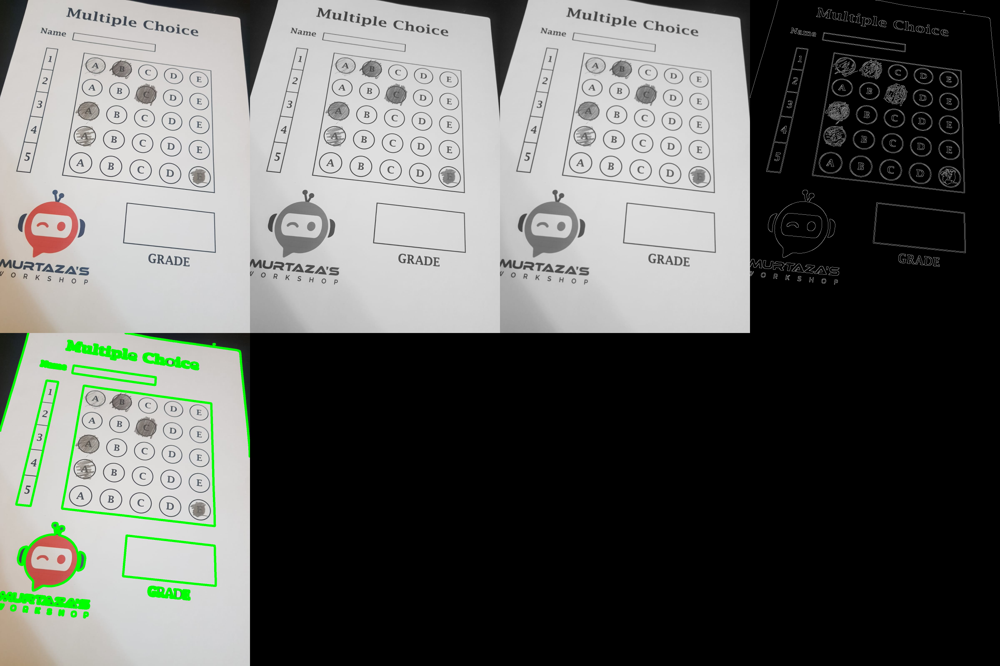

In [421]:
imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgBlank, imgBlank,imgBlank])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

# **Find rectangle**

In [422]:
def rectcountour(contours):
  rectcon=[]
  max_area =0
  for i in contours:
    # loop through all the contours
    area = cv2.contourArea(i)
    # gives the area of a contour
    if area>50:
      peri = cv2.arcLength(i,True)
      # perimeter
      # true indicates =closed perimeter
      approx = cv2.approxPolyDP(i,0.02*peri,True)# corner count # 0.02 is the resolution
      # filter it out by large rectangles
      # filter out if is has four corner points or not
      if len(approx)==4:
        rectcon.append(i)# to know how many points we have
        # if no of corners ==4 put it in a list
  rectcon = sorted(rectcon,  key =cv2.contourArea,reverse=True)# key on what are we sorting it out
  return rectcon


In [423]:
rectcon = rectcountour(contours)

In [424]:
# find the biggest contour of the image

def getcornerpoints(cont):
  peri = cv2.arcLength(cont,True)
  approx = cv2.approxPolyDP(cont,0.02*peri,True)
  return approx
biggestContour = getcornerpoints(rectcon[0])
print(biggestContour)
# if we want to see the second biggest recatngle
# biggestContour = getcornerpoints(rectcon[1])
# print(biggestContour)
gradepoints= getcornerpoints(rectcon[1])

[[[ 402  253]]

 [[ 298  843]]

 [[1030  927]]

 [[1013  338]]]


In [425]:
if biggestContour.size !=0 and gradepoints.size !=0:
  cv2.drawContours(imgbiggestcontours,[biggestContour],-1,(0,255,0),20)
  cv2.drawContours(imgbiggestcontours,[gradepoints],-1,(255,0,0),20)
  biggestContour = biggestContour.reshape(4,2)

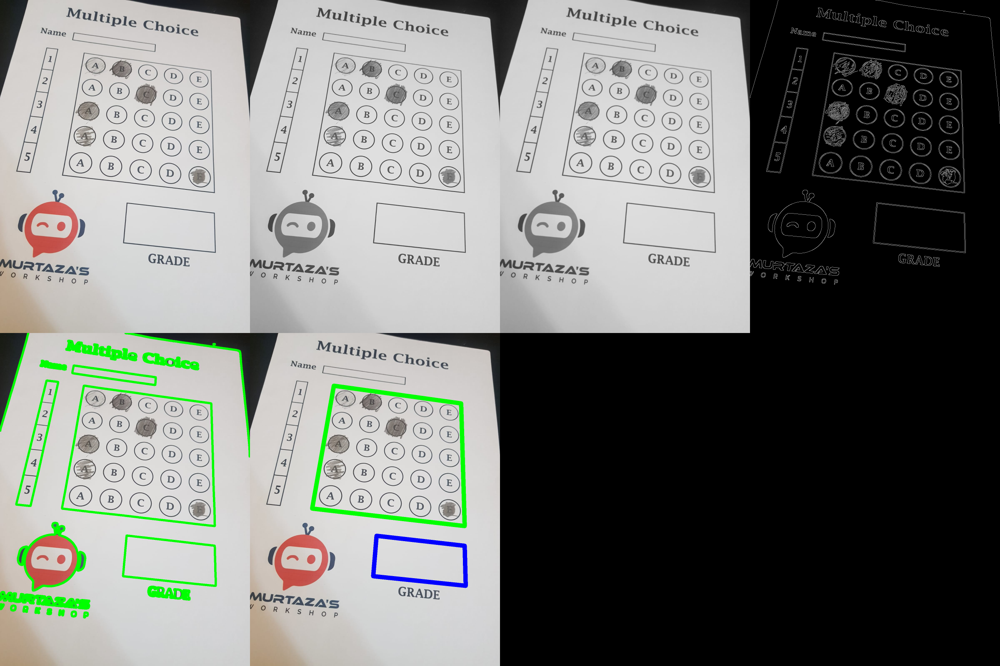

In [426]:
imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgbiggestcontours, imgBlank,imgBlank])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

In [427]:
# reorder because we want to make sure that they are in the exact same order
# if we do not reorder and send it to wrap the image will not come out properly
print(biggestContour.shape)

(4, 2)


In [428]:
def reorder(myPoints):
    if myPoints.ndim == 3:
        myPoints = myPoints.reshape(4, 2)
    add =myPoints.sum(1) # Correct indentation here
    myPointsNew = np.zeros_like(myPoints)
    # print(myPoints)
    # print(add)
    myPointsNew[0]=myPoints[np.argmin(add)]# [0,0], we need to find the minimum index of the array , first element
    myPointsNew[3]=myPoints[np.argmax(add)]# second element [width,  height]
    diff= np.diff(myPoints,axis=1)
    myPointsNew[1]=myPoints[np.argmin(diff)]# [width,0]
    myPointsNew[2]=myPoints[np.argmax(diff)]# [height,0]
    # print(diff)
    #[[-149][ 545][-103][-675]]
    return myPointsNew

# **BIRD'S EYE VIEW**

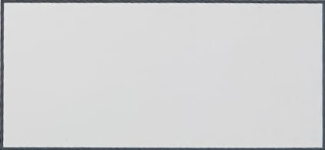

In [429]:
if biggestContour.size !=0 and gradepoints.size !=0:
  cv2.drawContours(imgbiggestcontours,[biggestContour],-1,(0,255,0),20)
  cv2.drawContours(imgbiggestcontours,[gradepoints],-1,(255,0,0),20)
  biggestContour = biggestContour.reshape(4,2)
  biggestContour=reorder(biggestContour)
  gradepoints =reorder(gradepoints)

  # [ 655 1141 1957 1351]
  # we can tell which is the origin point , the origin point is having the smallest sum

  pt1 = np.float32(biggestContour)
  pt2 = np.float32([[0,0],[widthImg,0],[0,heightImg],[widthImg,heightImg]])# defining the order
  matrix = cv2.getPerspectiveTransform(pt1,pt2)# get the marix
  imgWarpColored= cv2.warpPerspective(img,matrix,(widthImg,heightImg))

  # grade block display resized and extract
  # we will putn some value based on the score of the omr sheet marking
  ptg1 = np.float32(gradepoints)
  ptg2 = np.float32([[0,0],[325,0],[0,150],[325,150]])# defining the order
  matrixg = cv2.getPerspectiveTransform(ptg1,ptg2)# get the marix
  imggradepintsWarpColored= cv2.warpPerspective(img,matrixg,(325,150))
  cv2_imshow(imggradepintsWarpColored)

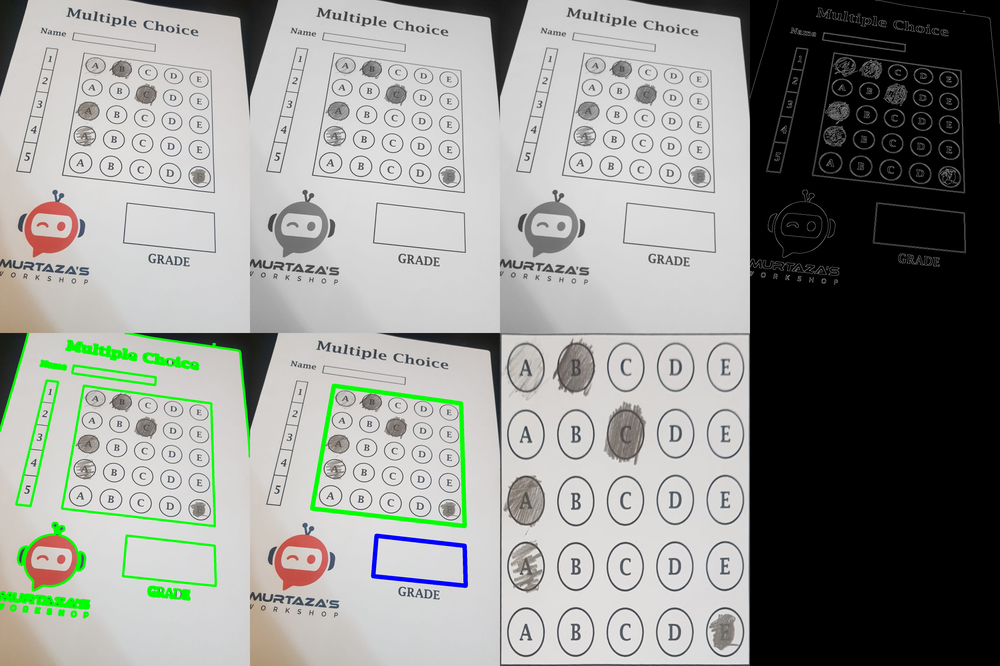

In [430]:
imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgbiggestcontours, imgWarpColored,imgBlank])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

# **Apply threshold to find the marking on OMR**

In [431]:
# the bubble that is marked will be having more amount of pixels (black)

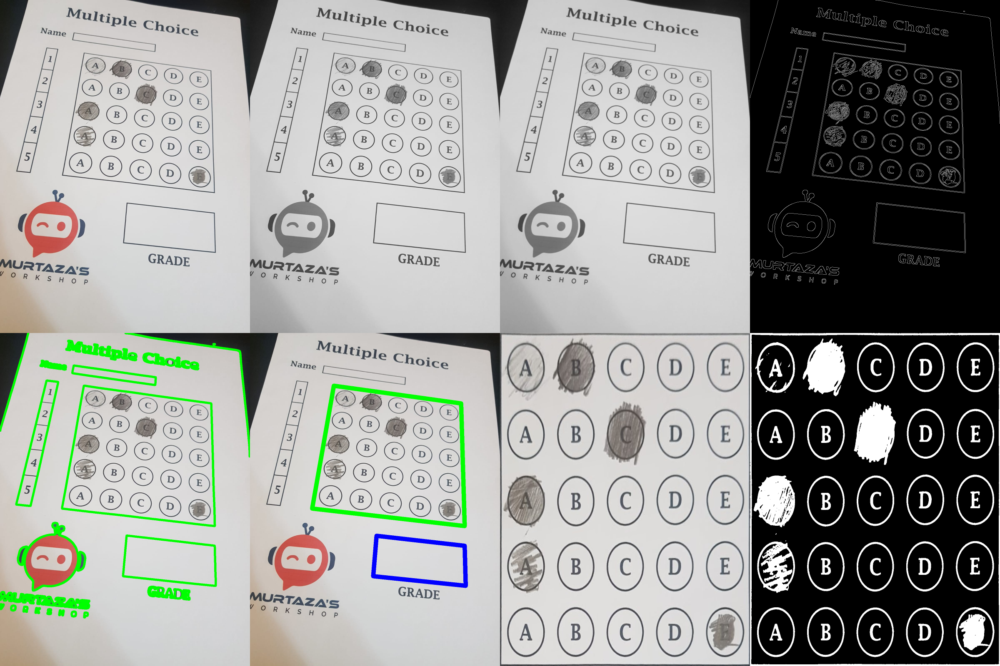

In [432]:
imgWarpGray =  cv2.cvtColor(imgWarpColored,cv2.COLOR_BGR2GRAY)
imgthresh = cv2.threshold(imgWarpGray,170,255,cv2.THRESH_BINARY_INV)[1]
# cv2.thresh_binary_inv -> black and white image bsed on threshold wale and inverse here acts in highlighting the marking in white color and background in black color
imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgbiggestcontours, imgWarpColored,imgthresh])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

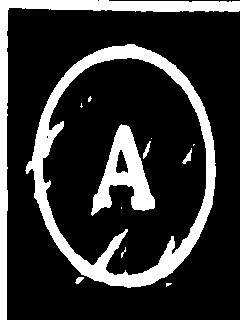

In [433]:
# to find which bubbles are marked and unmarked
# to extract and check each bubble we have to spit it into the 25 circles
def splitBoxes(img):
  boxes=[]
  rows =  np.vsplit(img,5)#vertical split

  for r in rows:
    cols=np.hsplit(r,5)#horizontal split
    for b in cols:
      boxes.append(b)
  return boxes

boxes = splitBoxes(imgthresh)
cv2_imshow(boxes[0])

In [434]:
# to count non zero pixels  of the boxes -> to find out which boxes are marked
print(cv2.countNonZero(boxes[1]),cv2.countNonZero(boxes[2]))

39689 9739


In [435]:
countpixels=np.zeros((questionrow,choices))
countc=0
countr=0

for image in boxes:
  totalpixels=cv2.countNonZero(image)
  countpixels[countr][countc] = totalpixels
  countc+=1
  if countc==choices:
    countc=0
    countr+=1
print(countpixels)
myIndex=[]
for x in range(0,questionrow):
  arr = countpixels[x] # Access elements within the NumPy array
  index = np.where(arr==np.amax(arr))
  myIndex.append(index[0][0])
print(myIndex)
 # find out where the max point is and save the index

[[15278. 39689.  9739. 10690. 11743.]
 [10300.  8269. 41657.  8148.  9277.]
 [36320.  8114.  7342.  8156.  9305.]
 [24868.  7927.  7225.  8097.  9619.]
 [11912. 10045.  9381. 10242. 24417.]]
[1, 2, 0, 0, 4]


# **Calculating Grades**

In [436]:
# compare ans and my index for grades calculate
grading=[]
for x in range (0,questionrow):
  if ans[x]==myIndex[x]:
    grading.append(1)
  else:
    grading.append(0)
print(grading)

[1, 1, 1, 0, 1]


In [437]:
score = (np.sum(grading)/questionrow)*100
print(score)

80.0


# **Displaying grading**

In [438]:
# green right ans , red for wrong ans
def showAnswers(img,myIndex,grading,ans,questionrow,choices):
  sectionwidth= int(img.shape[1]/questionrow)
  sectionheight= int (img.shape[0]/choices)
  for  x in range(0,questionrow):
    myAns = myIndex[x]
    centrex=(myAns*sectionwidth)+sectionwidth//2
    centrey=(x*sectionheight)+sectionheight//2
    if grading[x]==1:
      myColor=(0,255,0)
    else:
      myColor=(0,0,255)
      correctAns=ans[x]
      cv2.circle(img,((correctAns*sectionwidth)+sectionwidth//2,(x*sectionheight)+sectionheight//2),20,(0,255,0),cv2.FILLED)
    cv2.circle(img,(centrex,centrey),50,myColor,cv2.FILLED)
  return img
imgresult=imgWarpColored.copy()
imgresult=showAnswers(imgresult,myIndex,grading,ans,questionrow,choices)

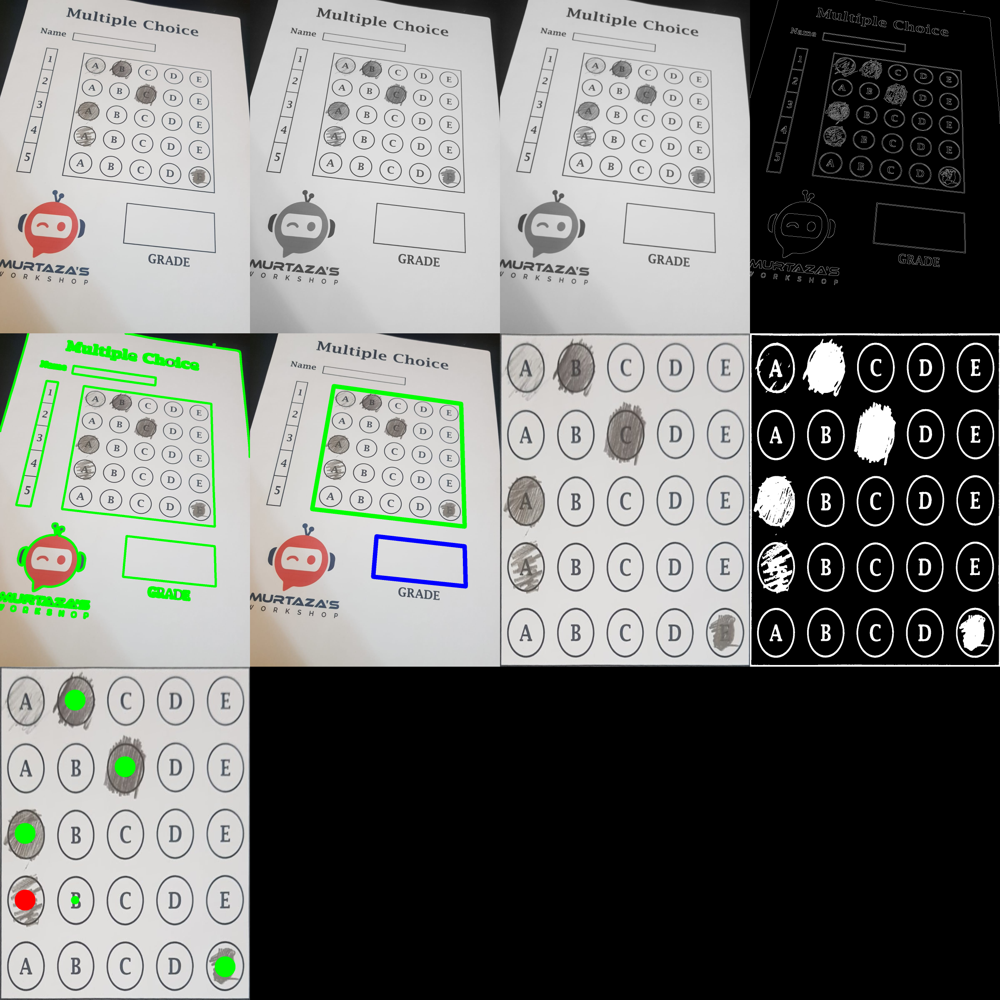

In [439]:
imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgbiggestcontours, imgWarpColored,imgthresh],[imgresult,imgBlank,imgBlank,imgBlank])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

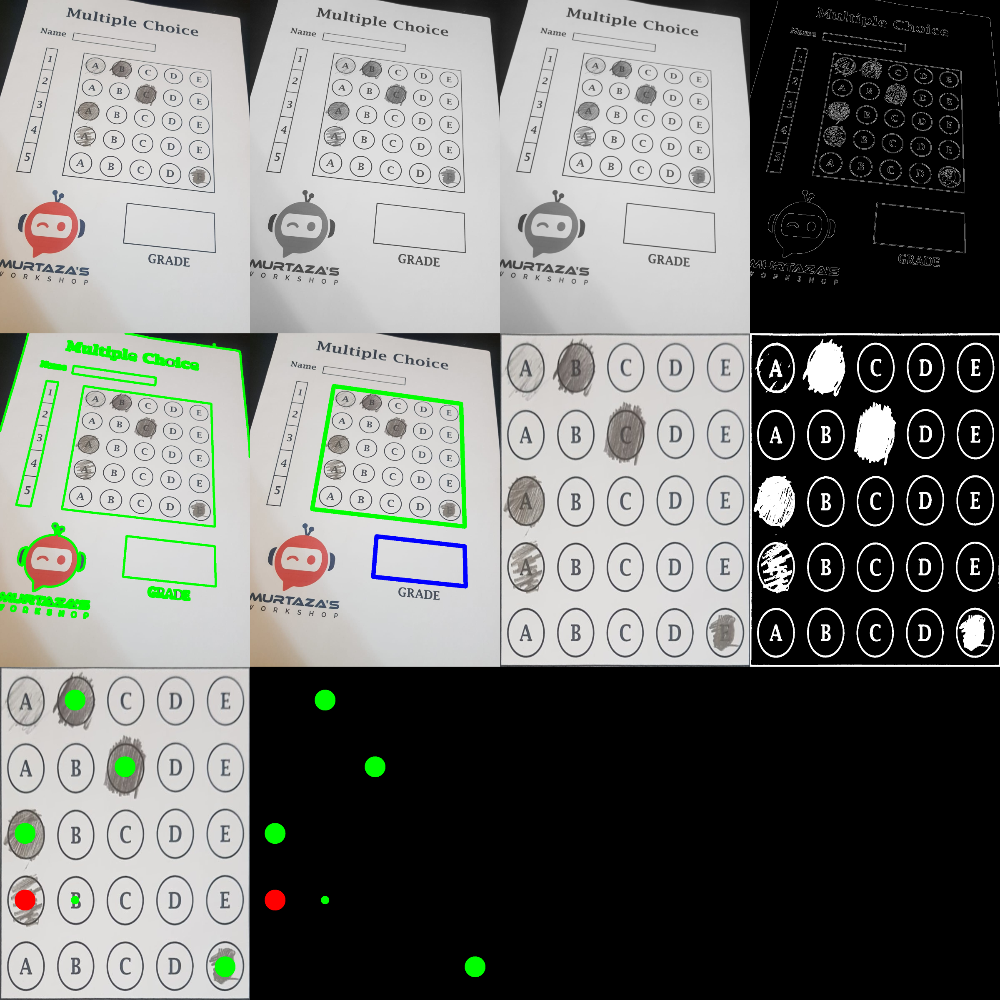

In [440]:
# we want to take only the  colored part from the last formed and overlaid to the first image
imagerawdrawing=np.zeros_like(imgWarpColored)
imagerawdrawing= showAnswers(imagerawdrawing,myIndex, grading , ans, questionrow,choices)
imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgbiggestcontours, imgWarpColored,imgthresh],[imgresult,imagerawdrawing,imgBlank,imgBlank])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

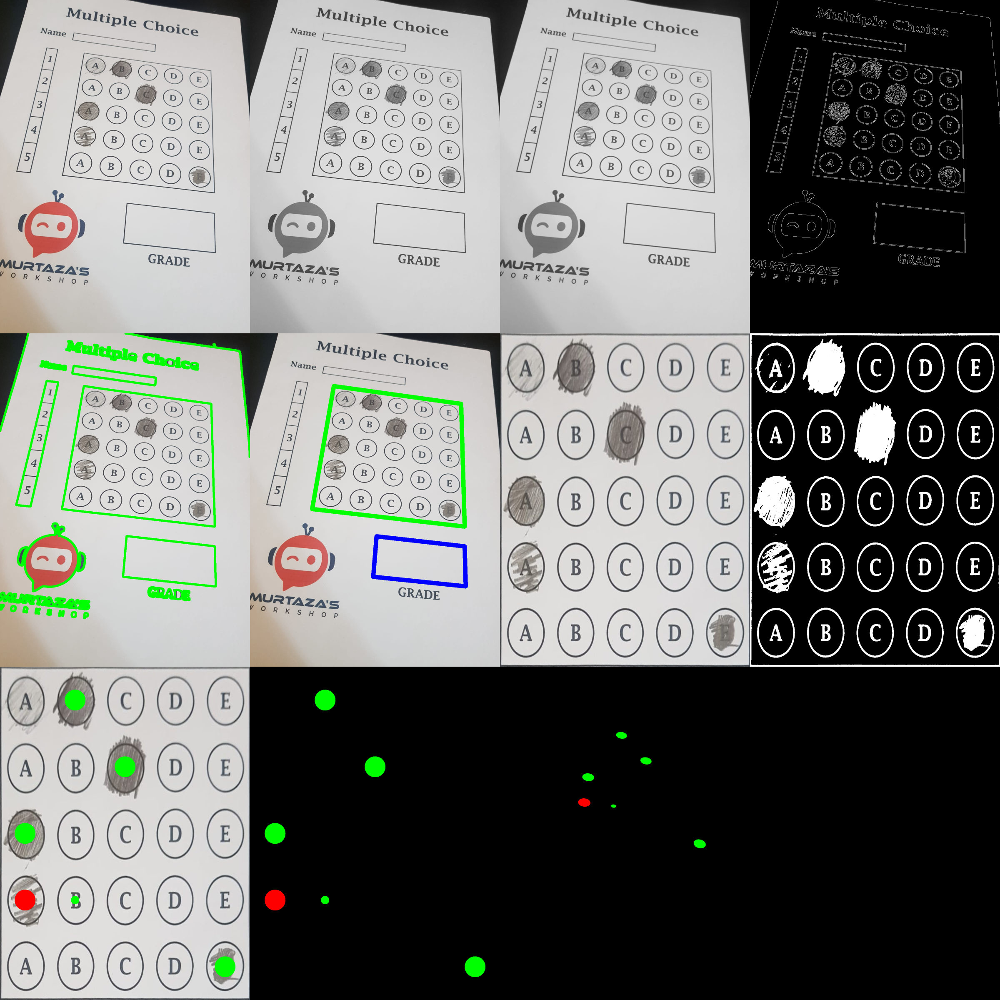

In [441]:
inv_matrix = cv2.getPerspectiveTransform(pt2,pt1)# get the inverse_marix
imginversewrap= cv2.warpPerspective(imagerawdrawing,inv_matrix,(widthImg,heightImg))
imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgbiggestcontours, imgWarpColored,imgthresh],[imgresult,imagerawdrawing,imginversewrap,imgBlank])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

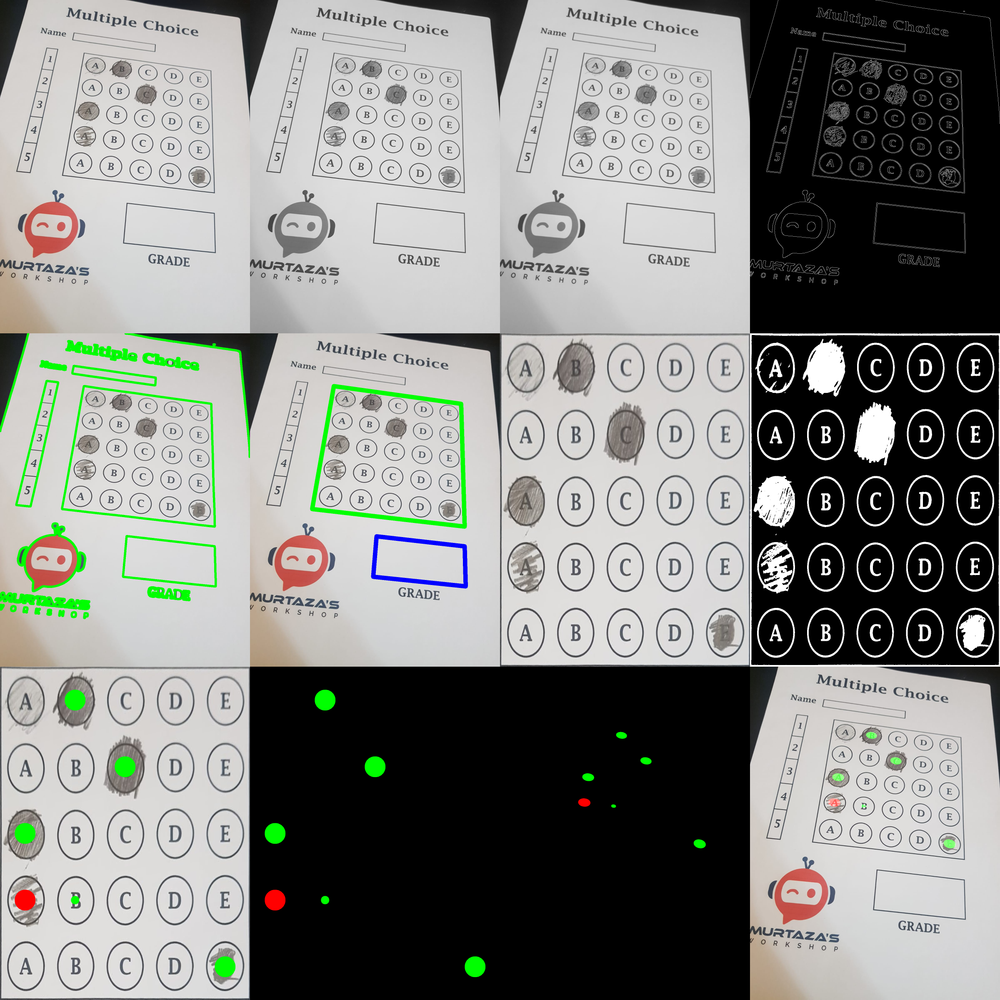

In [442]:
# combine last image and first
imgfinal = cv2.addWeighted(imgfinal,1,imginversewrap,1,0)


imgBlank=np.zeros_like(img)
imageArray=([img,img_gray,imgBlur,imgCanny],[imgcontours,imgbiggestcontours, imgWarpColored,imgthresh],[imgresult,imagerawdrawing,imginversewrap,imgfinal
                                                                                                        ])
imgStacked=stackImages(imageArray,0.5)
cv2_imshow(imgStacked)

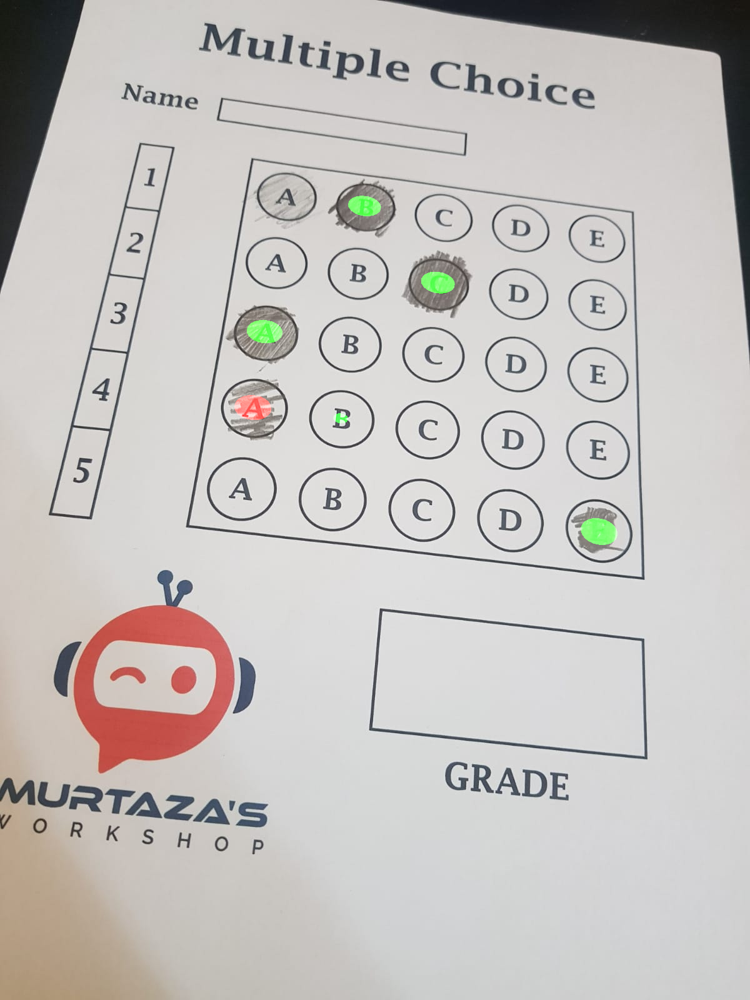

In [443]:
cv2_imshow(imgfinal)

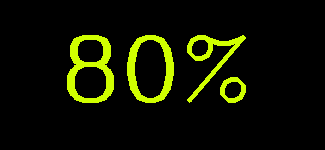

In [444]:
imgrawgrade=np.zeros_like(imggradepintsWarpColored)
cv2.putText(imgrawgrade,str(int(score))+"%",(60,100),cv2.FONT_HERSHEY_COMPLEX,3,(0,255,208),3)
cv2_imshow(imgrawgrade)


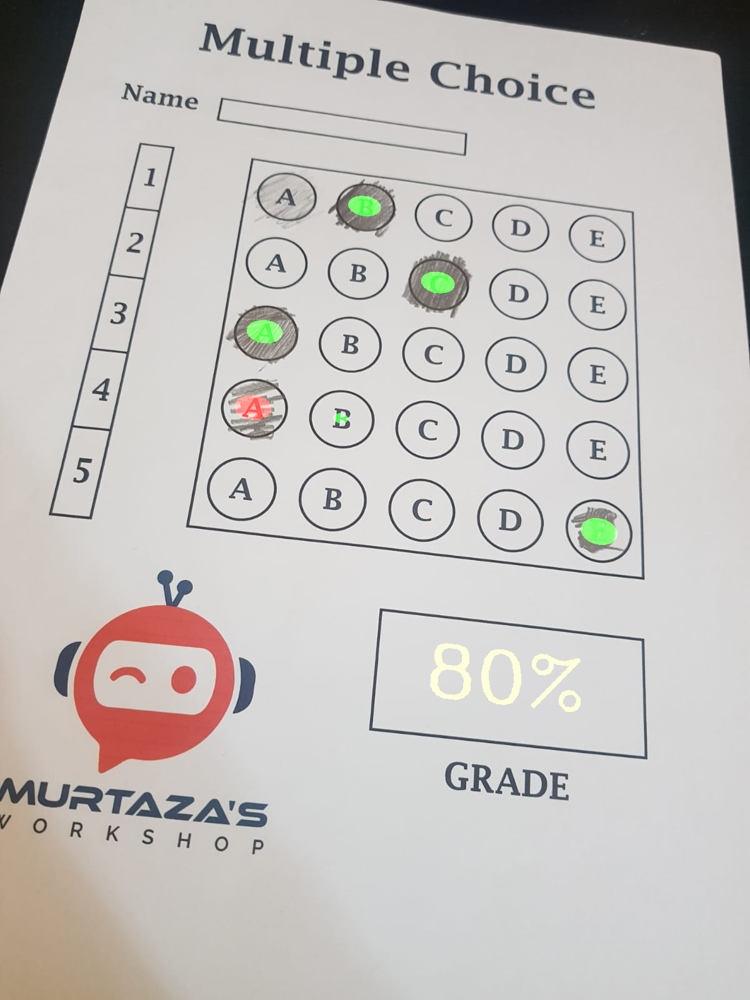

In [445]:
inv_matrixg = cv2.getPerspectiveTransform(ptg2,ptg1)
imginversegrade= cv2.warpPerspective(imgrawgrade,inv_matrixg,(widthImg,heightImg))
imgfinal= cv2.addWeighted(imgfinal,1,imginversegrade,1,0)
cv2_imshow(imgfinal)

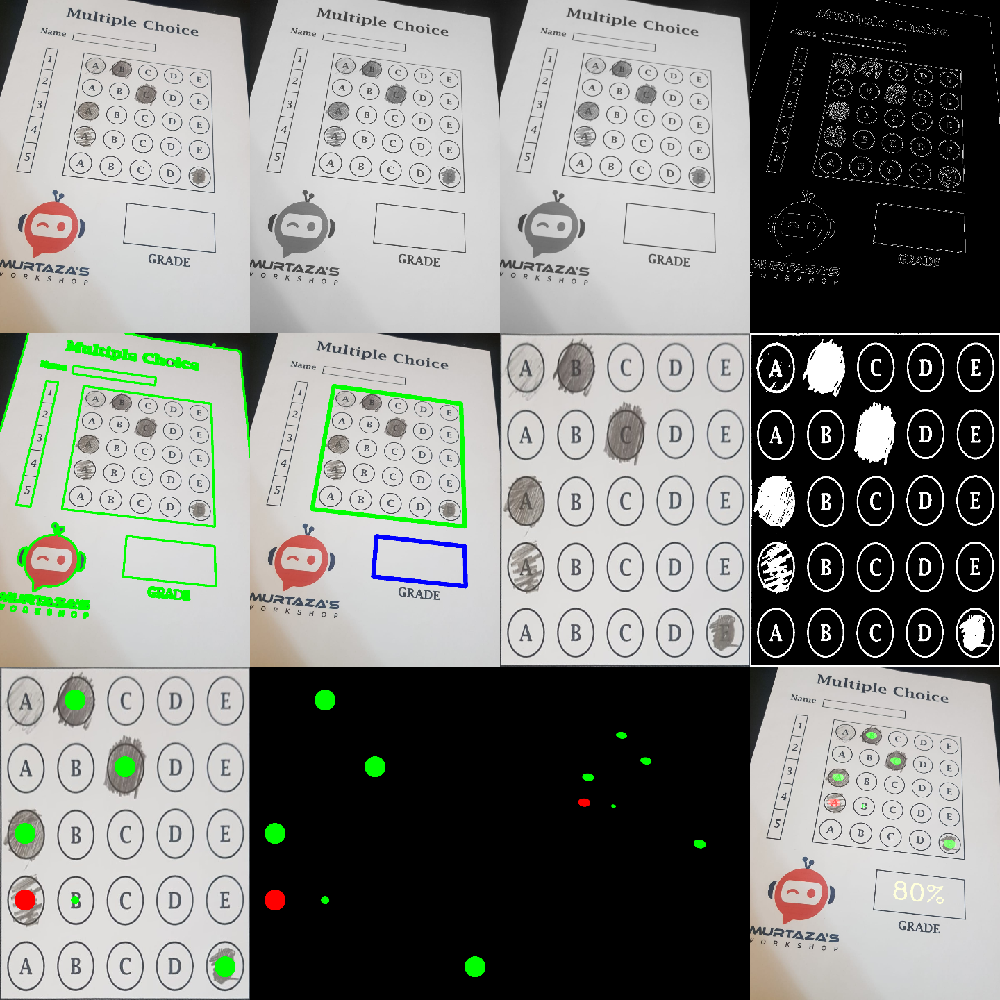

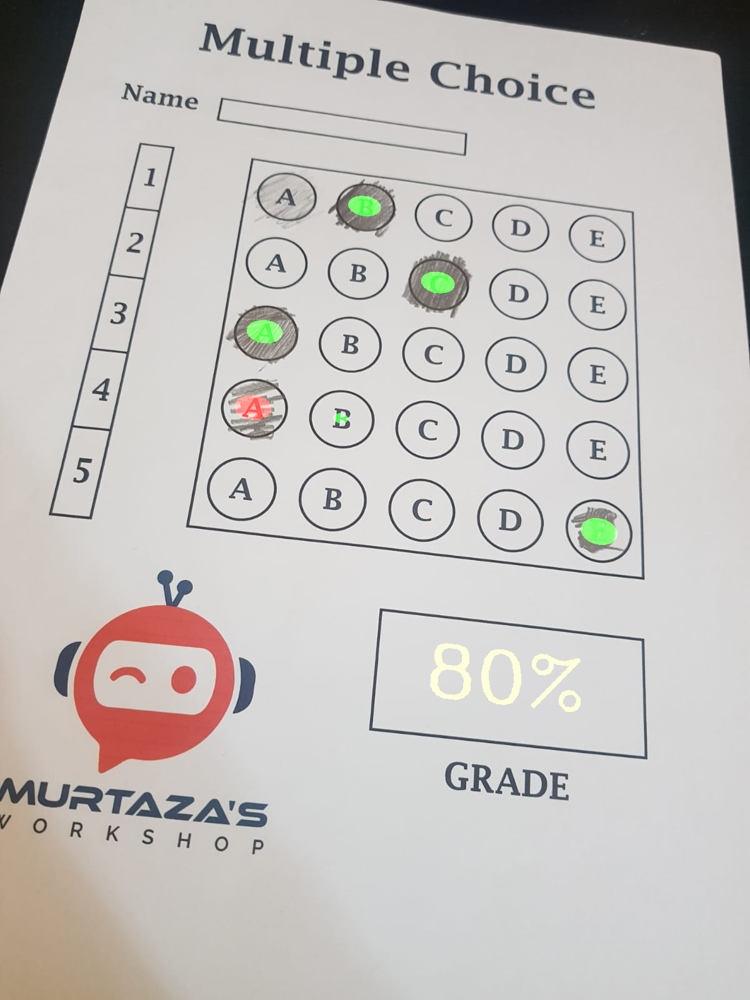

-1

In [446]:
imageArray = ([img, img_gray, imgBlur, imgCanny],
              [imgcontours, imgbiggestcontours, imgWarpColored, imgthresh],
              [imgresult, imagerawdrawing, imginversewrap, imgfinal])
lables = [["Original", "Gray", "Blur", "Canny"],
          ["Contours", "Biggest Contors", "Warp", "Threshold"],
          ["Results", "Raw Drawing", "Inv Warp", "Final im"]]

imgStacked = stackImages(imageArray, 0.3, lables)
# Use cv2_imshow instead of cv2.imshow
cv2_imshow(imgStacked)
cv2_imshow(imgfinal)
cv2.waitKey(0)

In [458]:
# for web  cam at last
# if cv2.waitKey(1) &0xFF == ord('s):
# cv2.imwrite("Final res.jpg",imgfinal)
#cv2.waitKey(300)